In [2]:
import os
import numpy as np
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import glob

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img, array_to_img
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [3]:
BASE_DIR = '/kaggle/input/anime-faces/data/'
WORKING_DIR = '/kaggle/working'

In [4]:
image_paths = glob.glob(BASE_DIR+'*.png')

In [5]:
image_paths[:5]

['/kaggle/input/anime-faces/data/21130.png',
 '/kaggle/input/anime-faces/data/9273.png',
 '/kaggle/input/anime-faces/data/18966.png',
 '/kaggle/input/anime-faces/data/14127.png',
 '/kaggle/input/anime-faces/data/18054.png']

# Visualizations

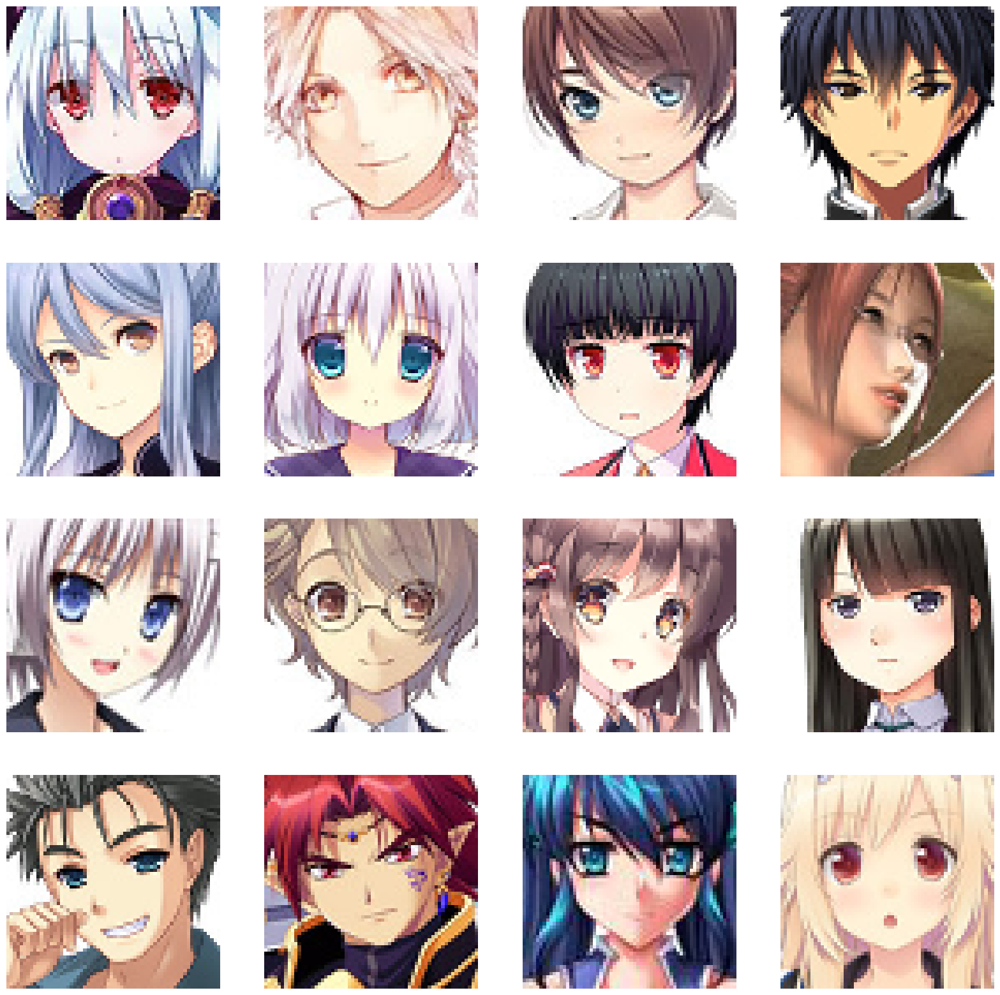

In [6]:
# to display grid of images (7x7)
plt.figure(figsize=(20, 20))
temp_images = image_paths[:16]
index = 1

for image_path in temp_images:
    plt.subplot(4, 4, index)
    # load the image
    img = load_img(image_path)
    # convert to numpy array
    img = np.array(img)
    # show the image
    plt.imshow(img)
    plt.axis('off')
    # increment the index for next image
    index += 1

# Preprocess

In [24]:
# load the image and convert to numpy array
train_images = [np.array(load_img(path)) for path in tqdm(image_paths)]
train_images = np.array(train_images)

  0%|          | 0/21551 [00:00<?, ?it/s]

In [25]:
train_images.shape

(21551, 64, 64, 3)

In [26]:
train_images.shape[0]

21551

In [27]:
train_images[0]

array([[[ 35,  12,  36],
        [ 37,  15,  40],
        [ 38,   0,  36],
        ...,
        [116, 129, 177],
        [103, 135, 185],
        [ 84, 110, 165]],

       [[ 35,  12,  36],
        [ 34,  17,  38],
        [ 61,  17,  55],
        ...,
        [ 90, 129, 166],
        [117, 147, 195],
        [ 97, 139, 186]],

       [[ 38,  14,  38],
        [ 36,  16,  39],
        [ 55,  19,  53],
        ...,
        [ 99, 150, 189],
        [110, 150, 188],
        [119, 159, 192]],

       ...,

       [[ 88,  40,  90],
        [ 83,  40,  80],
        [ 88,  59,  82],
        ...,
        [ 26,   2,  29],
        [ 22,  16,  18],
        [ 30,  10,  25]],

       [[ 86,  46,  90],
        [ 71,  35,  72],
        [ 58,  27,  58],
        ...,
        [ 21,   3,  37],
        [ 35,  16,  31],
        [ 33,  11,  39]],

       [[ 54,  22,  58],
        [ 56,  17,  60],
        [ 53,  18,  54],
        ...,
        [ 33,  17,  49],
        [ 35,   8,  37],
        [ 30,   9,  36]]

# Create generator and discriminator model

In [28]:
LATENT_DIM = 100
WEIGHT_INIT = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
CHANNELS = 3 

# GEnerator model

In [41]:
model = Sequential(name='generator')

# 1d random noise
model.add(layers.Dense(8 * 8 * 512, input_dim=LATENT_DIM))
model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# convert 1d to 2d
model.add(layers.Reshape((8, 8, 512)))

# upsample to 16x16
model.add(layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# upsample to 32x32
model.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# upsample to 64x64
model.add(layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Conv2D(CHANNELS, (4, 4), padding='same', activation='relu'))

generator_1 = model
generator_1.summary()

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_4 (Dense)             (None, 32768)             3309568   
                                                                 
 batch_normalization_14 (Ba  (None, 32768)             131072    
 tchNormalization)                                               
                                                                 
 re_lu_8 (ReLU)              (None, 32768)             0         
                                                                 
 reshape_2 (Reshape)         (None, 8, 8, 512)         0         
                                                                 
 conv2d_transpose_6 (Conv2D  (None, 16, 16, 256)       2097408   
 Transpose)                                                      
                                                                 
 batch_normalization_15 (Ba  (None, 16, 16, 256)       10

# Discriminator model

In [42]:
model = Sequential(name='discriminator')
input_shape = (64, 64, 3)
alpha = 0.2

# create conv layers
model.add(layers.Conv2D(64, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same'))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same'))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))

# output class
model.add(layers.Dense(1, activation='sigmoid'))

discriminator_1 = model
discriminator_1.summary()

Model: "discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_9 (Conv2D)           (None, 32, 32, 64)        3136      
                                                                 
 batch_normalization_18 (Ba  (None, 32, 32, 64)        256       
 tchNormalization)                                               
                                                                 
 leaky_re_lu_6 (LeakyReLU)   (None, 32, 32, 64)        0         
                                                                 
 conv2d_10 (Conv2D)          (None, 16, 16, 128)       131200    
                                                                 
 batch_normalization_19 (Ba  (None, 16, 16, 128)       512       
 tchNormalization)                                               
                                                                 
 leaky_re_lu_7 (LeakyReLU)   (None, 16, 16, 128)     

# DCGAN

In [43]:
class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')

    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]

    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn

    def train_step(self, real_images):
        # get batch size from the data
        batch_size = tf.shape(real_images)[0]
        # generate random noise
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))

        # train the discriminator with real (1) and fake (0) images
        with tf.GradientTape() as tape:
            # compute loss on real images
            pred_real = self.discriminator(real_images, training=True)
            # generate real image labels
            real_labels = tf.ones((batch_size, 1))
            # label smoothing
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)

            # compute loss on fake images
            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training=True)
            # generate fake labels
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)

            # total discriminator loss
            d_loss = (d_loss_real + d_loss_fake) / 2

        # compute discriminator gradients
        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
        # update the gradients
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))


        # train the generator model
        labels = tf.ones((batch_size, 1))
        # generator want discriminator to think that fake images are real
        with tf.GradientTape() as tape:
            # generate fake images from generator
            fake_images = self.generator(random_noise, training=True)
            # classify images as real or fake
            pred_fake = self.discriminator(fake_images, training=True)
            # compute loss
            g_loss = self.loss_fn(labels, pred_fake)

        # compute gradients
        gradients = tape.gradient(g_loss, self.generator.trainable_variables)
        # update the gradients
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))

        # update states for both models
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)

        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}


In [44]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        # create random noise for generating images
        self.noise = tf.random.normal([num_imgs, latent_dim])

    def on_epoch_end(self, epoch, logs=None):
        # generate the image from noise
        g_img = self.model.generator(self.noise)
        # denormalize the image
        #g_img = g_img * 255
        #g_img = preprocess(g_img, while_train = True)

        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        # plt.savefig('epoch_{:03d}.png'.format(epoch))
        plt.show()

    def on_train_end(self, logs=None):
        self.model.generator.save('generator.h1')

In [46]:
dcgan_ = DCGAN(generator=generator_1, discriminator=discriminator_1, latent_dim=LATENT_DIM)

In [47]:
D_LR = 0.0001 
G_LR = 0.0003
dcgan_.compile(g_optimizer=Adam(learning_rate=G_LR, beta_1=0.5), d_optimizer=Adam(learning_rate=D_LR, beta_1=0.5), loss_fn=BinaryCrossentropy())

Epoch 1/50
673/674 [============================>.] - ETA: 0s - d_loss: -0.3464 - g_loss: 0.6335

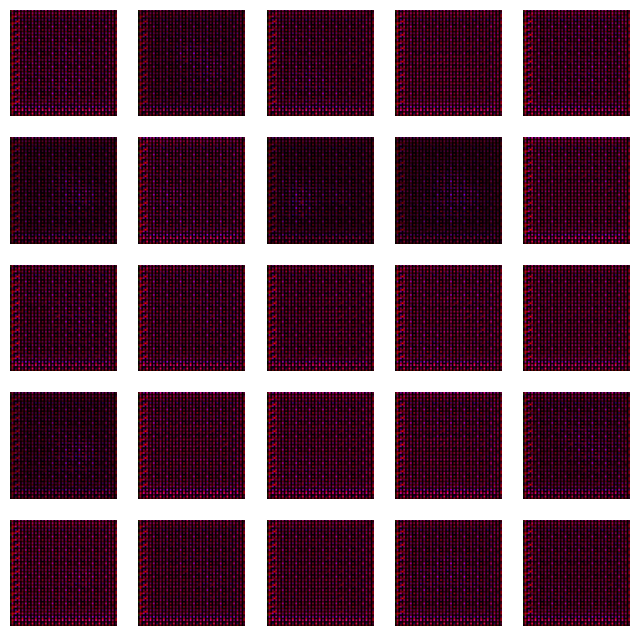

674/674 [==============================] - 55s 72ms/step - d_loss: -0.3469 - g_loss: 0.6326
Epoch 2/50
673/674 [============================>.] - ETA: 0s - d_loss: -0.4823 - g_loss: 0.9181

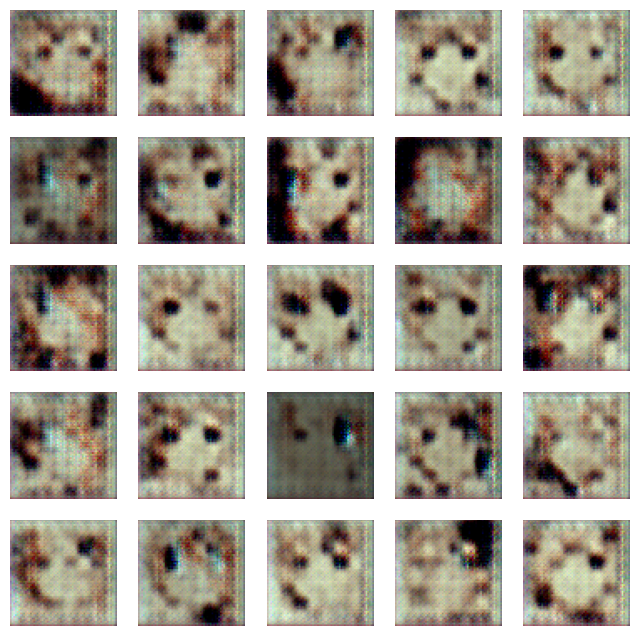

674/674 [==============================] - 48s 71ms/step - d_loss: -0.4810 - g_loss: 0.9167
Epoch 3/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6262 - g_loss: 0.3645

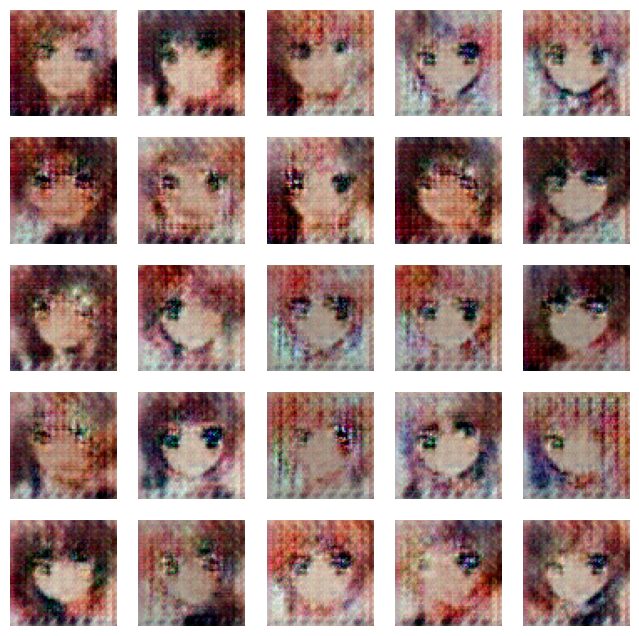

674/674 [==============================] - 101s 149ms/step - d_loss: 0.6266 - g_loss: 0.3650
Epoch 4/50
673/674 [============================>.] - ETA: 0s - d_loss: 1.0204 - g_loss: 0.5064

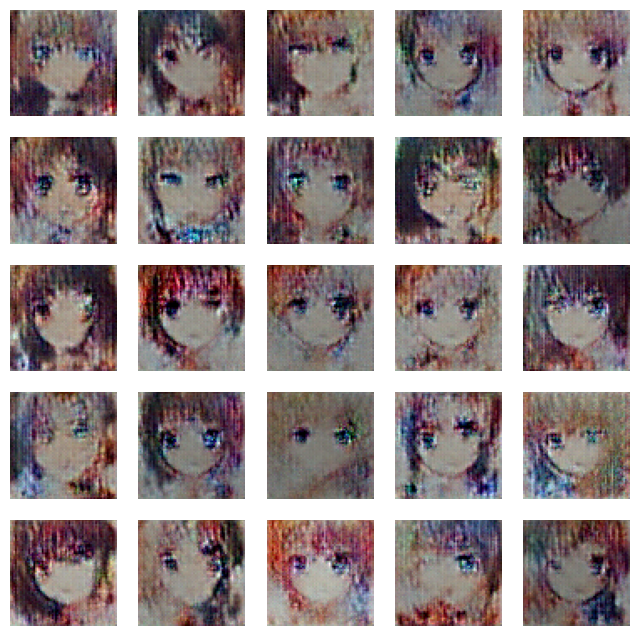

674/674 [==============================] - 48s 72ms/step - d_loss: 1.0202 - g_loss: 0.5065
Epoch 5/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.9259 - g_loss: 0.6317

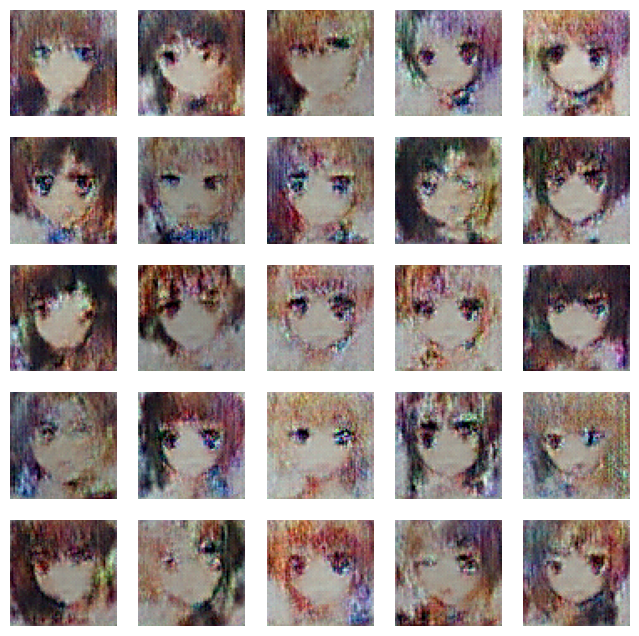

674/674 [==============================] - 48s 71ms/step - d_loss: 0.9259 - g_loss: 0.6318
Epoch 6/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.8427 - g_loss: 0.6642

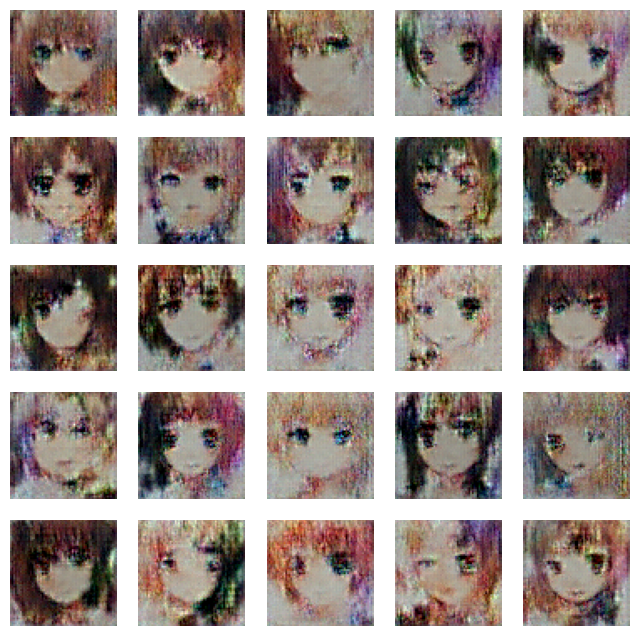

674/674 [==============================] - 48s 72ms/step - d_loss: 0.8427 - g_loss: 0.6642
Epoch 7/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7953 - g_loss: 0.6806

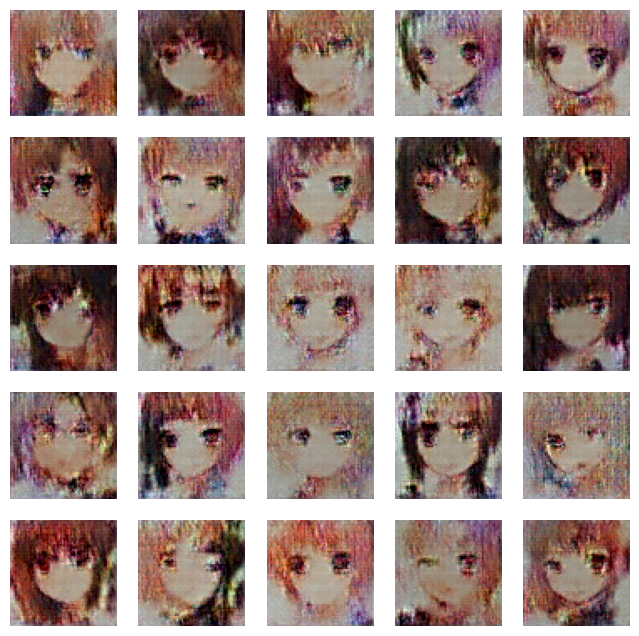

674/674 [==============================] - 49s 72ms/step - d_loss: 0.7955 - g_loss: 0.6806
Epoch 8/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7711 - g_loss: 0.6772

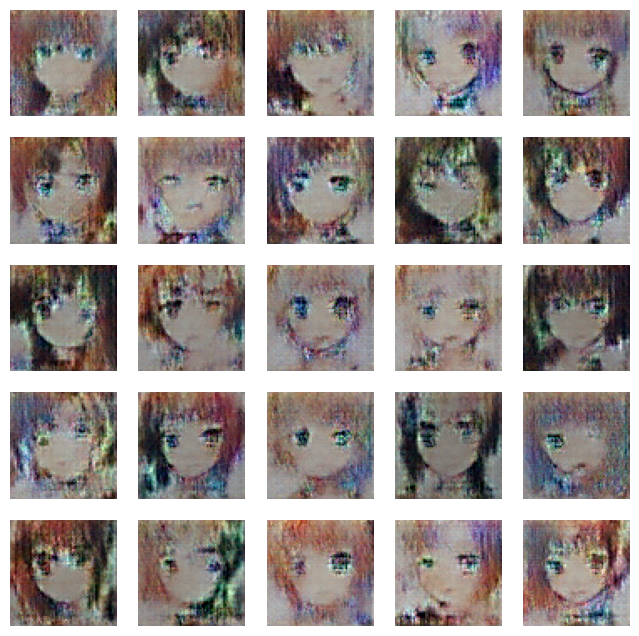

674/674 [==============================] - 48s 72ms/step - d_loss: 0.7710 - g_loss: 0.6771
Epoch 9/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7476 - g_loss: 0.6643

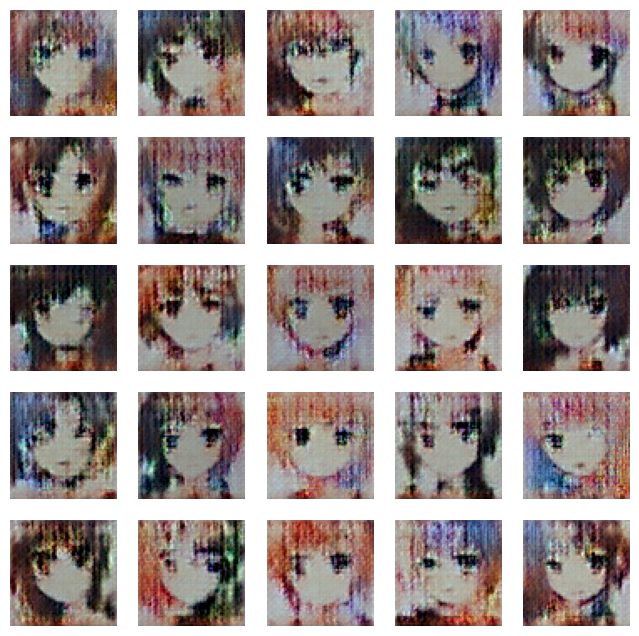

674/674 [==============================] - 48s 72ms/step - d_loss: 0.7474 - g_loss: 0.6646
Epoch 10/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7335 - g_loss: 0.6581

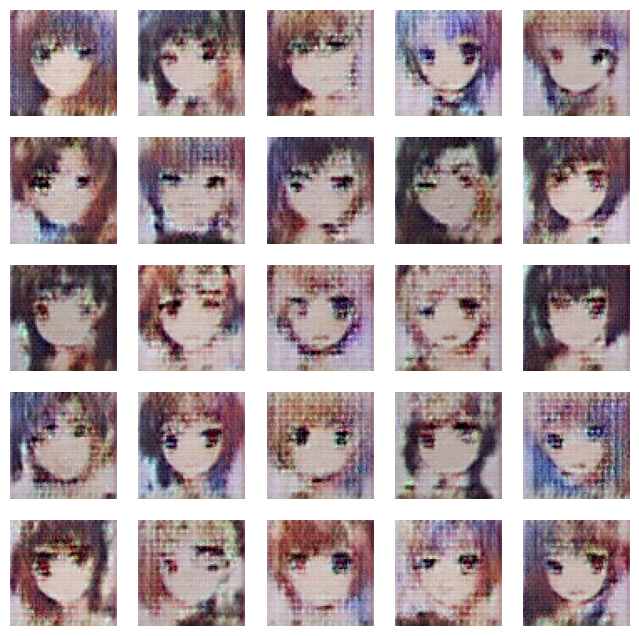

674/674 [==============================] - 48s 72ms/step - d_loss: 0.7335 - g_loss: 0.6581
Epoch 11/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7311 - g_loss: 0.6564

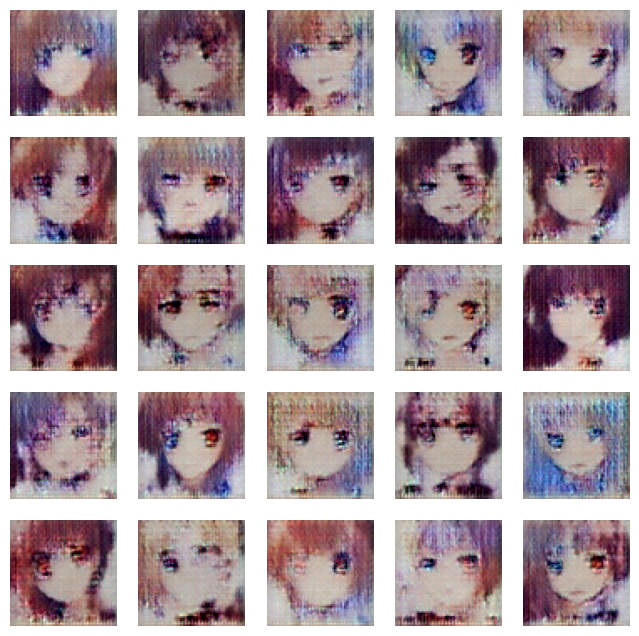

674/674 [==============================] - 49s 72ms/step - d_loss: 0.7311 - g_loss: 0.6567
Epoch 12/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7100 - g_loss: 0.6511

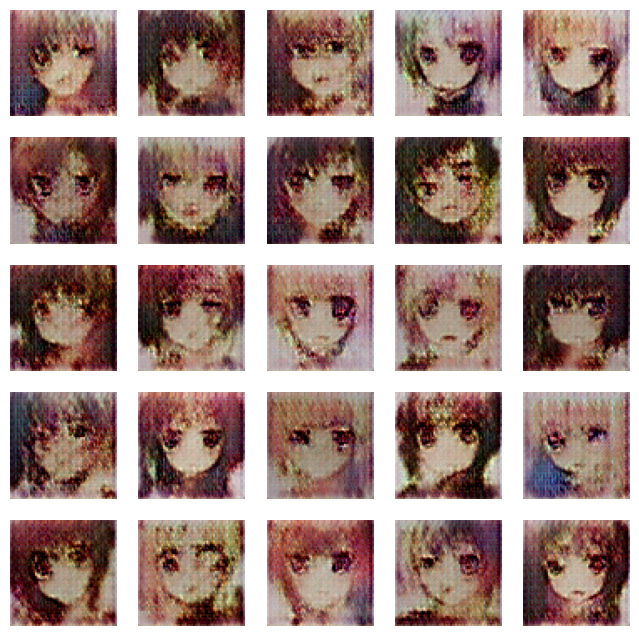

674/674 [==============================] - 48s 72ms/step - d_loss: 0.7102 - g_loss: 0.6512
Epoch 13/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6428 - g_loss: 0.5650

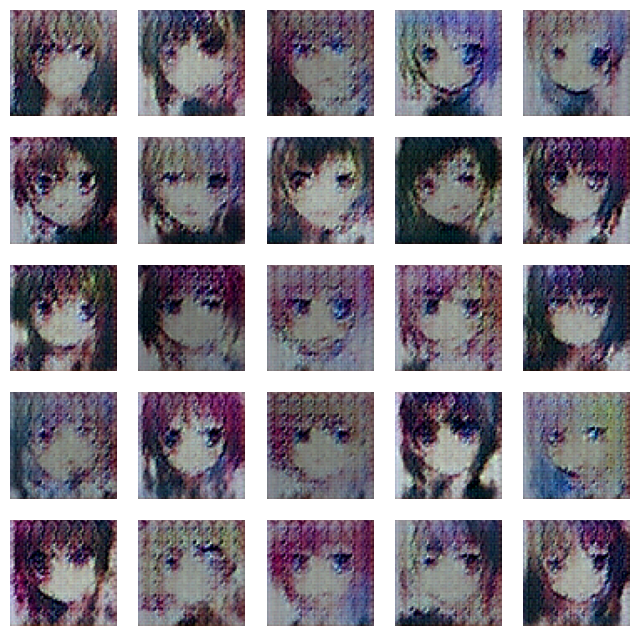

674/674 [==============================] - 48s 72ms/step - d_loss: 0.6426 - g_loss: 0.5649
Epoch 14/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5925 - g_loss: 0.4168

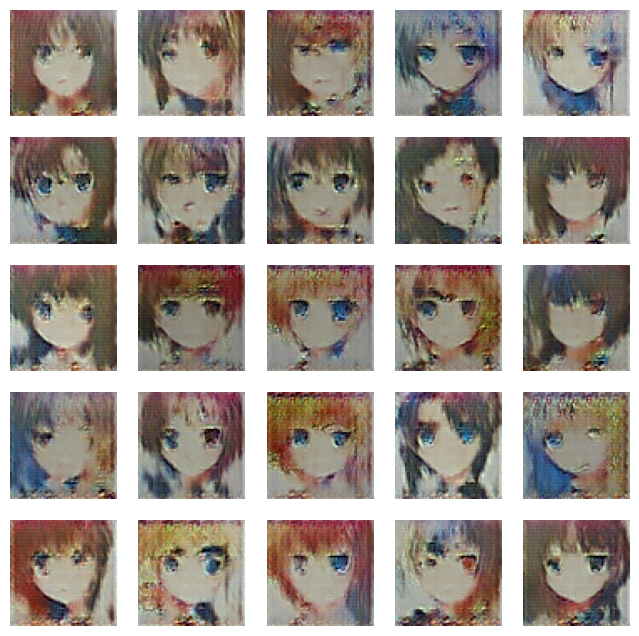

674/674 [==============================] - 48s 71ms/step - d_loss: 0.5924 - g_loss: 0.4166
Epoch 15/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6569 - g_loss: 0.3996

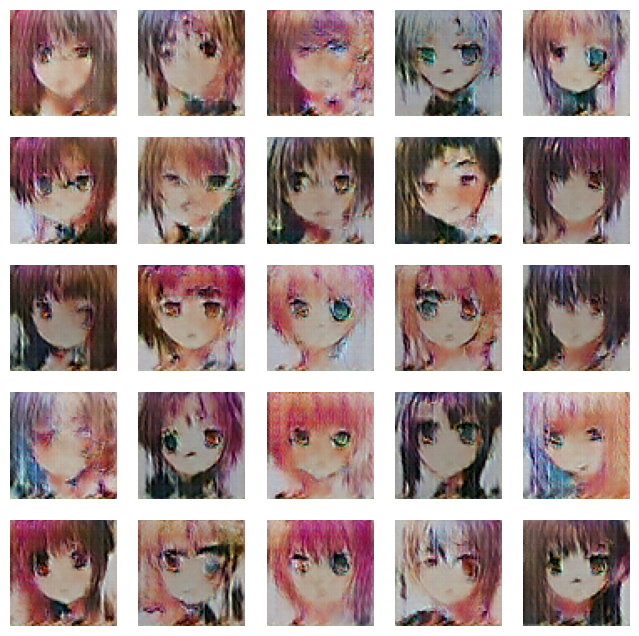

674/674 [==============================] - 49s 72ms/step - d_loss: 0.6572 - g_loss: 0.3998
Epoch 16/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7831 - g_loss: 0.5380

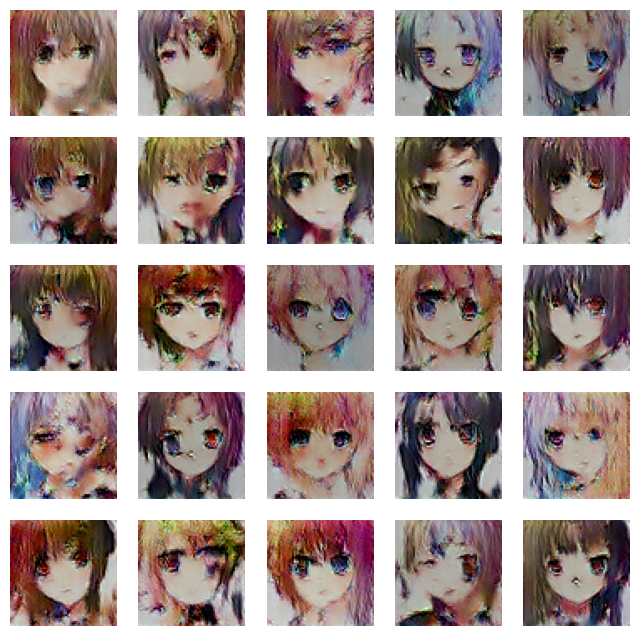

674/674 [==============================] - 48s 72ms/step - d_loss: 0.7832 - g_loss: 0.5380
Epoch 17/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7612 - g_loss: 0.6265

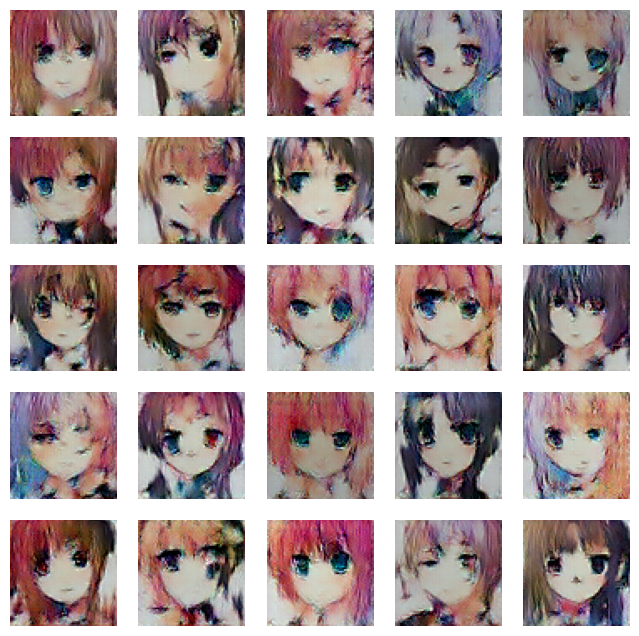

674/674 [==============================] - 48s 72ms/step - d_loss: 0.7613 - g_loss: 0.6266
Epoch 18/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7338 - g_loss: 0.6510

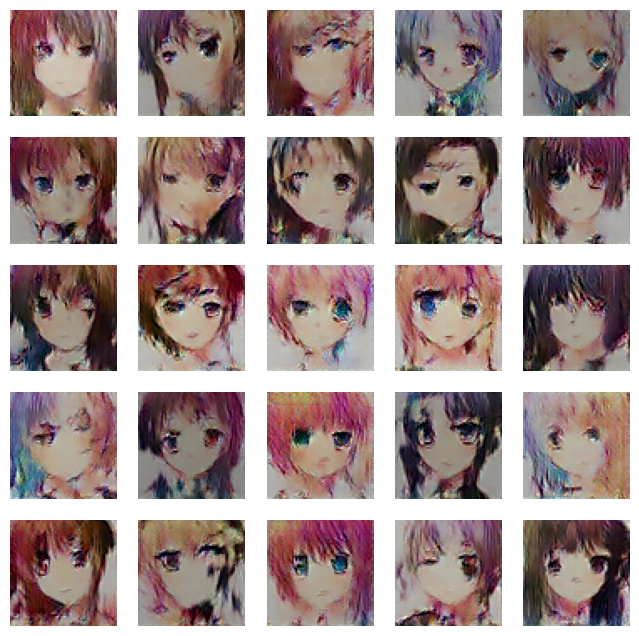

674/674 [==============================] - 48s 71ms/step - d_loss: 0.7337 - g_loss: 0.6510
Epoch 19/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7213 - g_loss: 0.6611

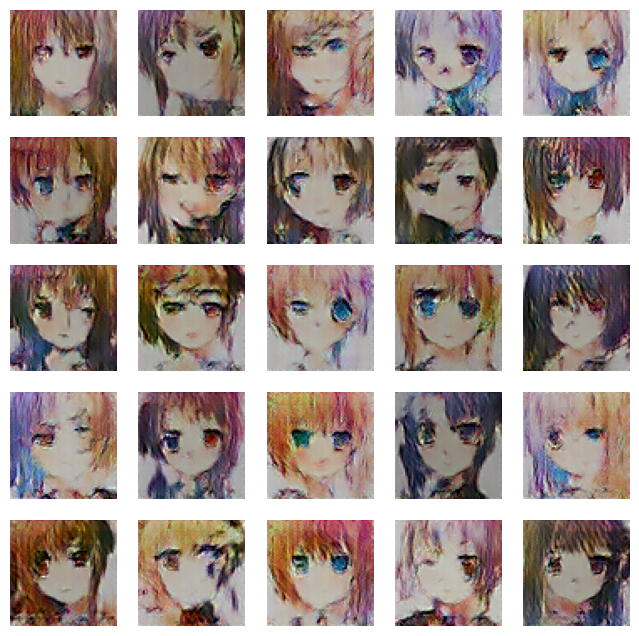

674/674 [==============================] - 49s 72ms/step - d_loss: 0.7213 - g_loss: 0.6609
Epoch 20/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7141 - g_loss: 0.6624

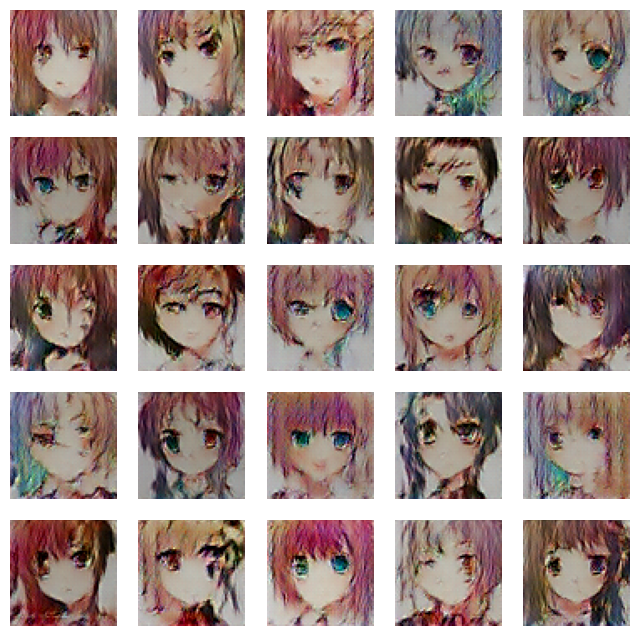

674/674 [==============================] - 48s 72ms/step - d_loss: 0.7141 - g_loss: 0.6624
Epoch 21/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7107 - g_loss: 0.6623

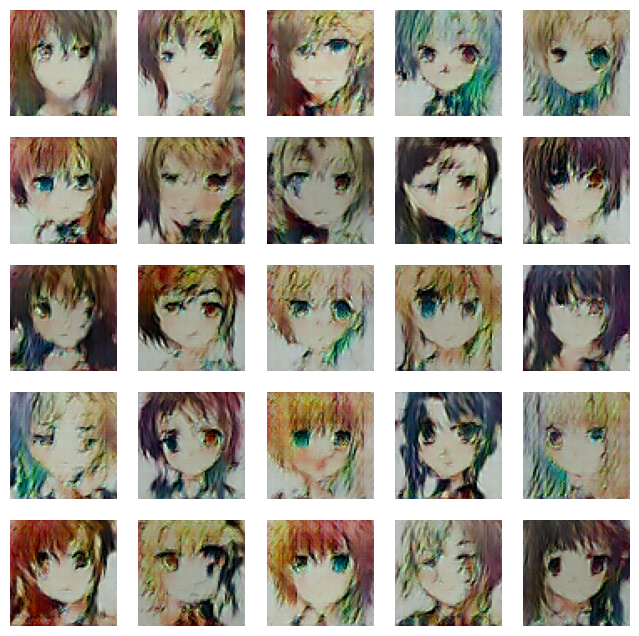

674/674 [==============================] - 48s 72ms/step - d_loss: 0.7106 - g_loss: 0.6622
Epoch 22/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7066 - g_loss: 0.6570

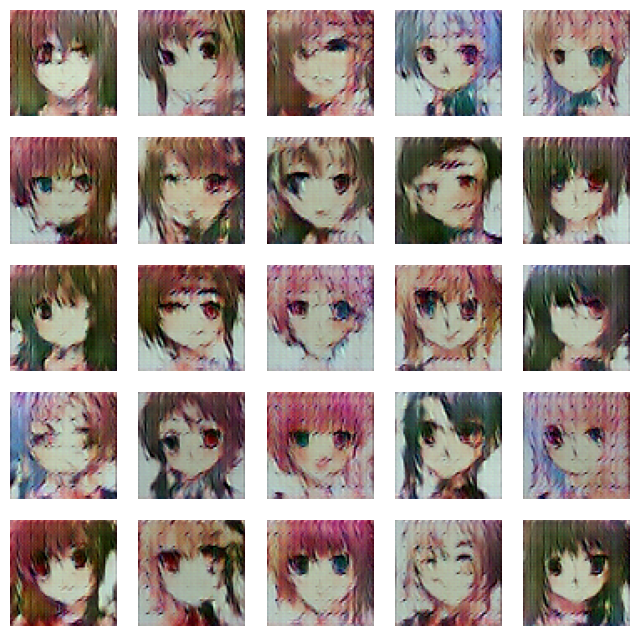

674/674 [==============================] - 48s 72ms/step - d_loss: 0.7066 - g_loss: 0.6571
Epoch 23/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7016 - g_loss: 0.6579

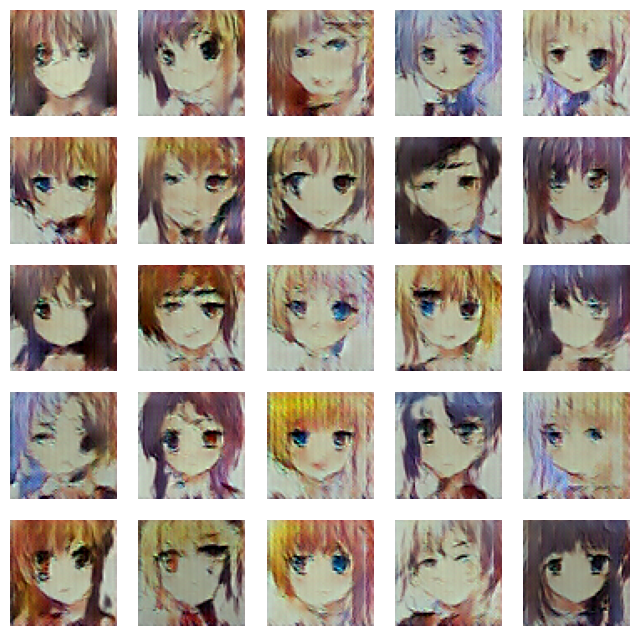

674/674 [==============================] - 49s 72ms/step - d_loss: 0.7016 - g_loss: 0.6580
Epoch 24/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7040 - g_loss: 0.6567

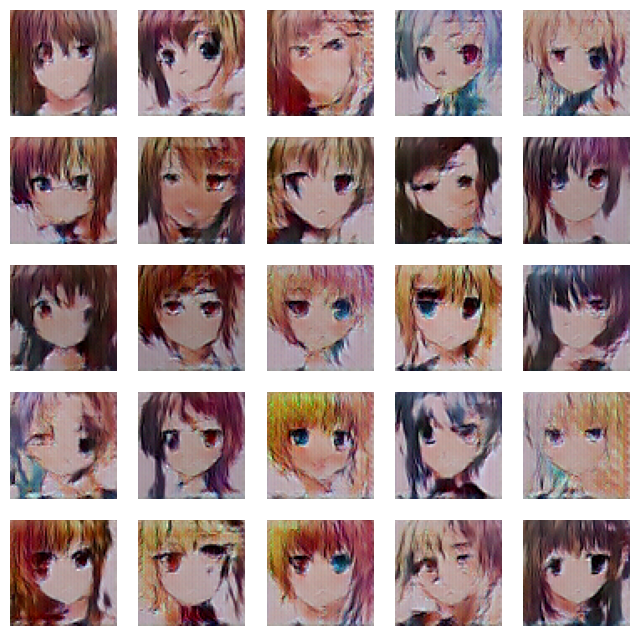

674/674 [==============================] - 48s 71ms/step - d_loss: 0.7040 - g_loss: 0.6568
Epoch 25/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6959 - g_loss: 0.6506

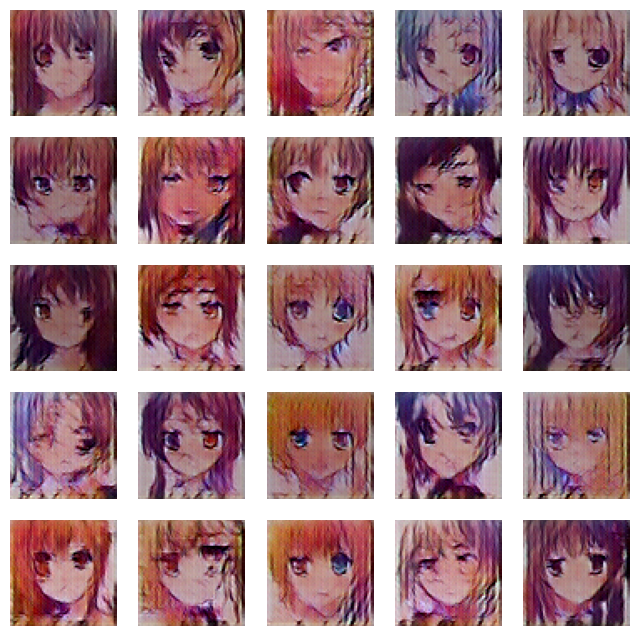

674/674 [==============================] - 48s 71ms/step - d_loss: 0.6958 - g_loss: 0.6508
Epoch 26/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6729 - g_loss: 0.5792

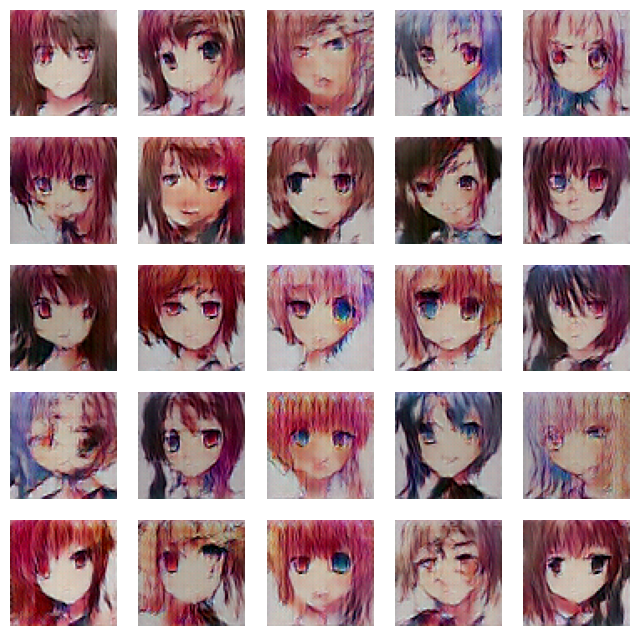

674/674 [==============================] - 48s 71ms/step - d_loss: 0.6729 - g_loss: 0.5797
Epoch 27/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7031 - g_loss: 0.6193

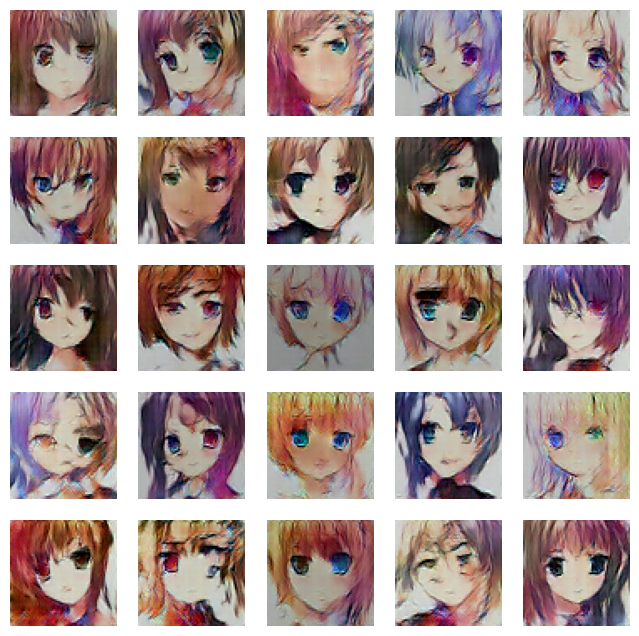

674/674 [==============================] - 49s 72ms/step - d_loss: 0.7031 - g_loss: 0.6193
Epoch 28/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7137 - g_loss: 0.6530

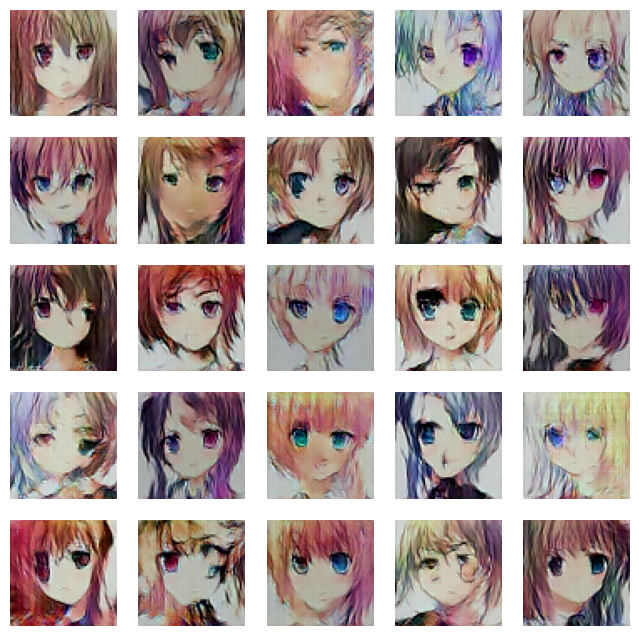

674/674 [==============================] - 48s 71ms/step - d_loss: 0.7137 - g_loss: 0.6531
Epoch 29/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7109 - g_loss: 0.6630

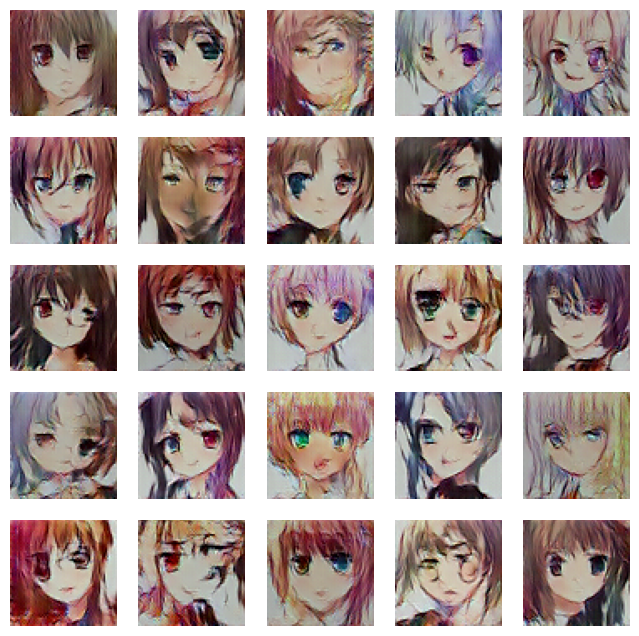

674/674 [==============================] - 48s 71ms/step - d_loss: 0.7109 - g_loss: 0.6630
Epoch 30/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7075 - g_loss: 0.6652

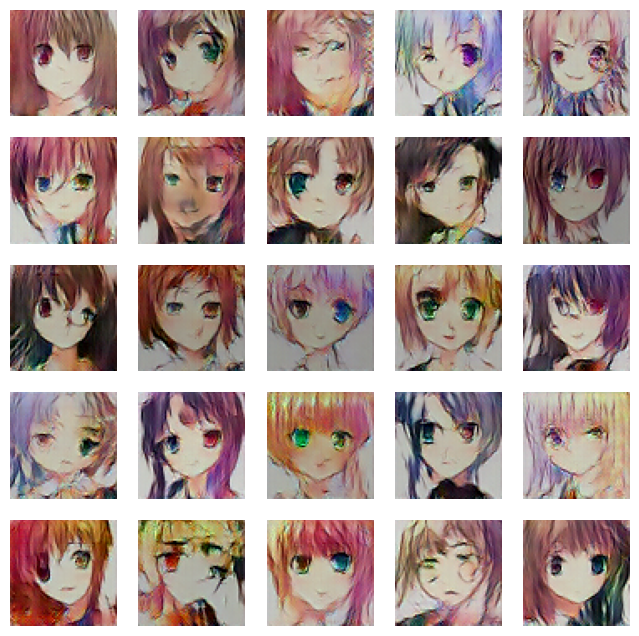

674/674 [==============================] - 48s 72ms/step - d_loss: 0.7076 - g_loss: 0.6652
Epoch 31/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7049 - g_loss: 0.6700

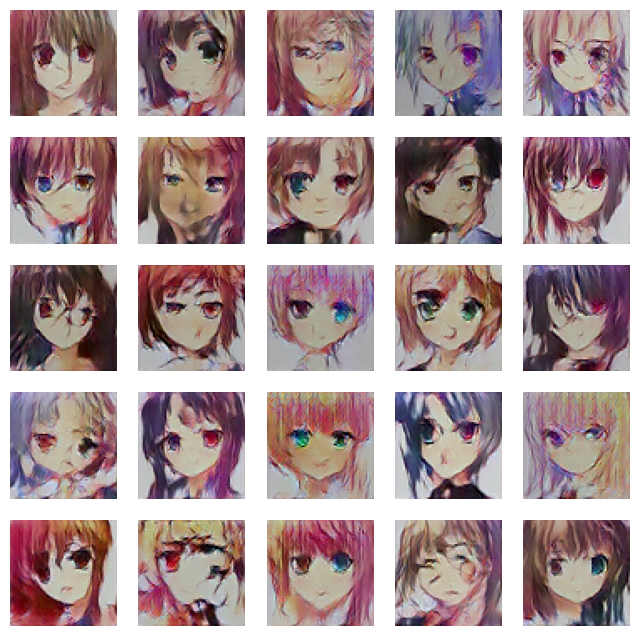

674/674 [==============================] - 49s 73ms/step - d_loss: 0.7049 - g_loss: 0.6700
Epoch 32/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7040 - g_loss: 0.6693

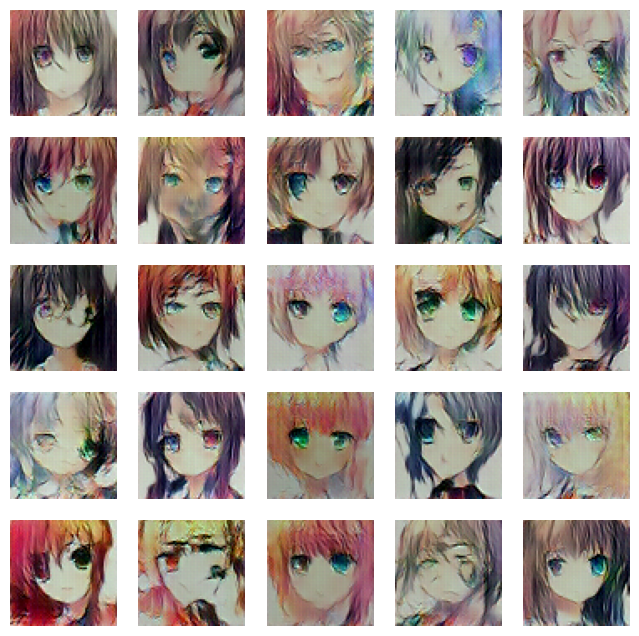

674/674 [==============================] - 48s 71ms/step - d_loss: 0.7039 - g_loss: 0.6694
Epoch 33/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7008 - g_loss: 0.6688

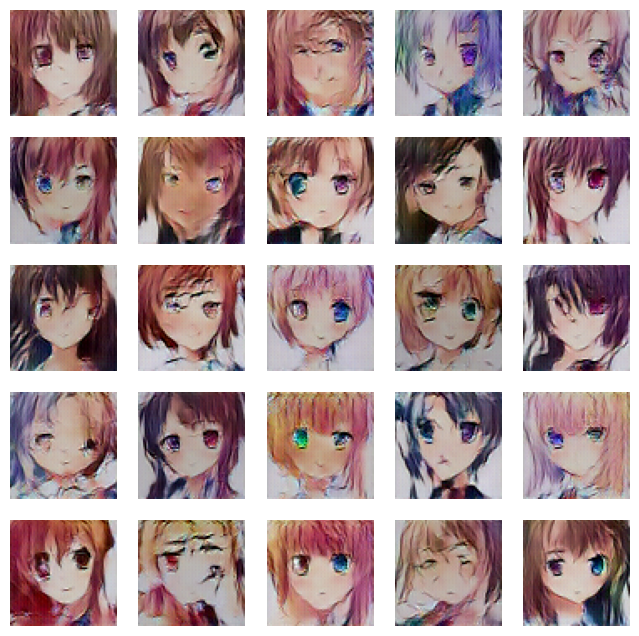

674/674 [==============================] - 48s 71ms/step - d_loss: 0.7007 - g_loss: 0.6687
Epoch 34/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7016 - g_loss: 0.6698

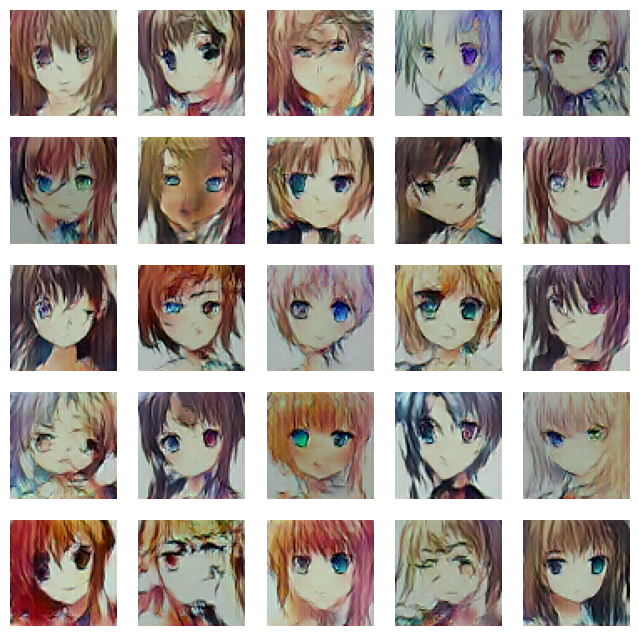

674/674 [==============================] - 48s 72ms/step - d_loss: 0.7016 - g_loss: 0.6699
Epoch 35/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7006 - g_loss: 0.6719

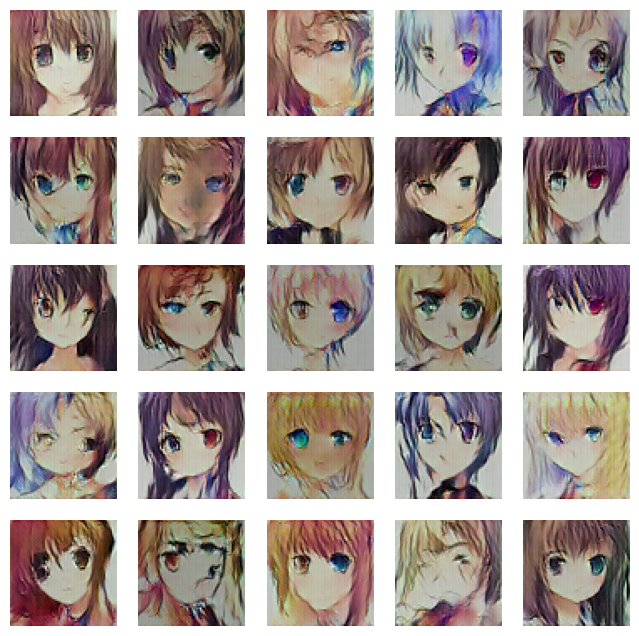

674/674 [==============================] - 49s 72ms/step - d_loss: 0.7006 - g_loss: 0.6719
Epoch 36/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7001 - g_loss: 0.6715

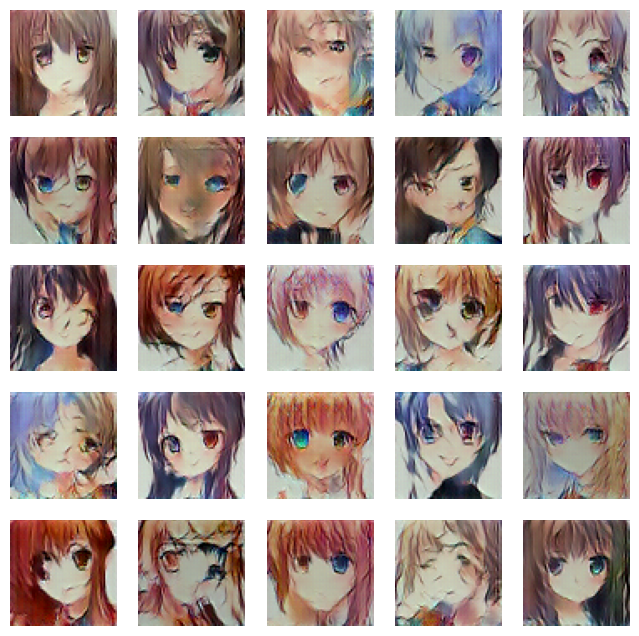

674/674 [==============================] - 48s 71ms/step - d_loss: 0.7001 - g_loss: 0.6715
Epoch 37/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6977 - g_loss: 0.6691

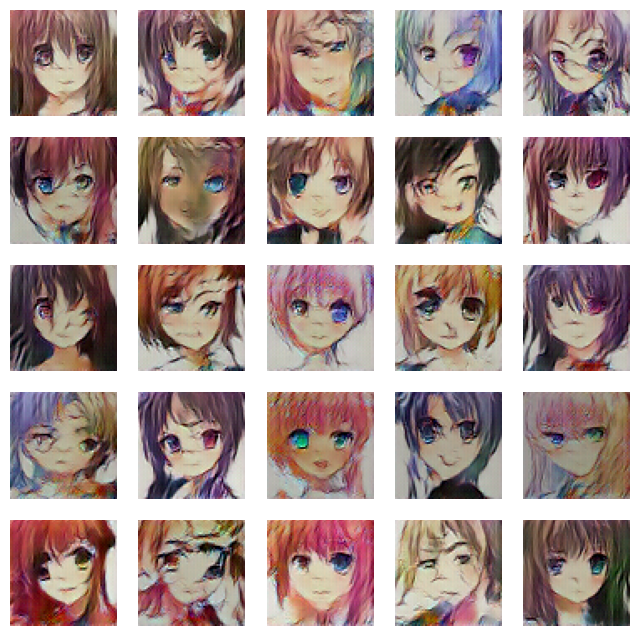

674/674 [==============================] - 48s 71ms/step - d_loss: 0.6977 - g_loss: 0.6692
Epoch 38/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6983 - g_loss: 0.6700

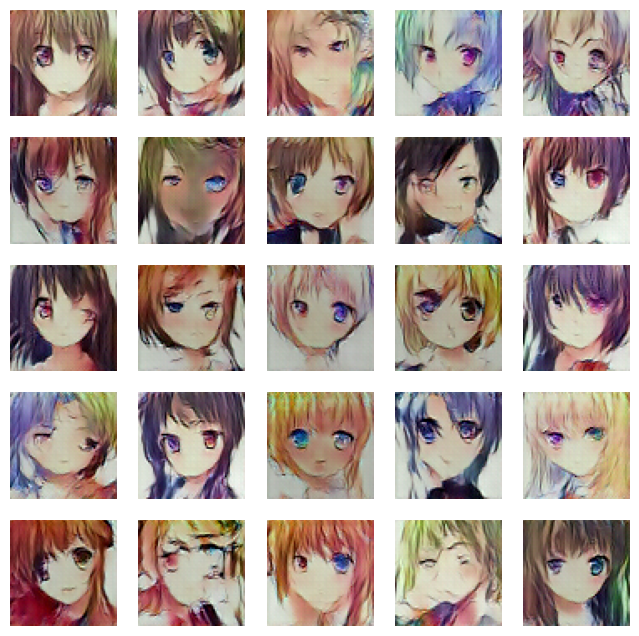

674/674 [==============================] - 48s 71ms/step - d_loss: 0.6983 - g_loss: 0.6699
Epoch 39/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6985 - g_loss: 0.6731

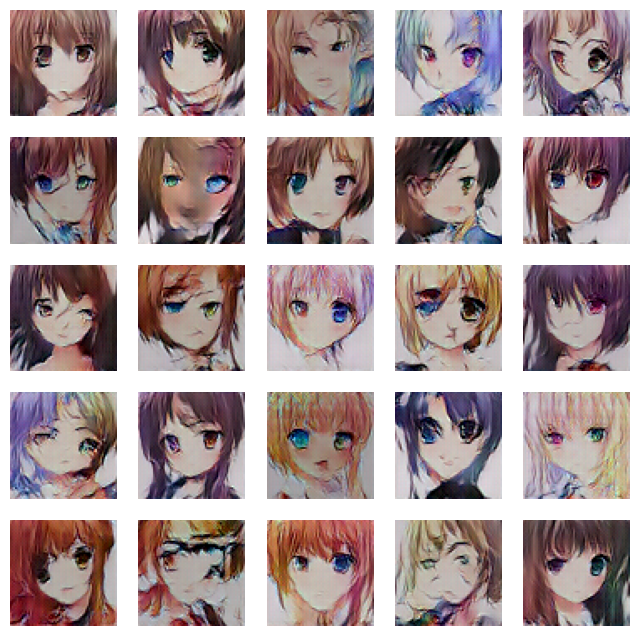

674/674 [==============================] - 49s 72ms/step - d_loss: 0.6985 - g_loss: 0.6732
Epoch 40/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6994 - g_loss: 0.6721

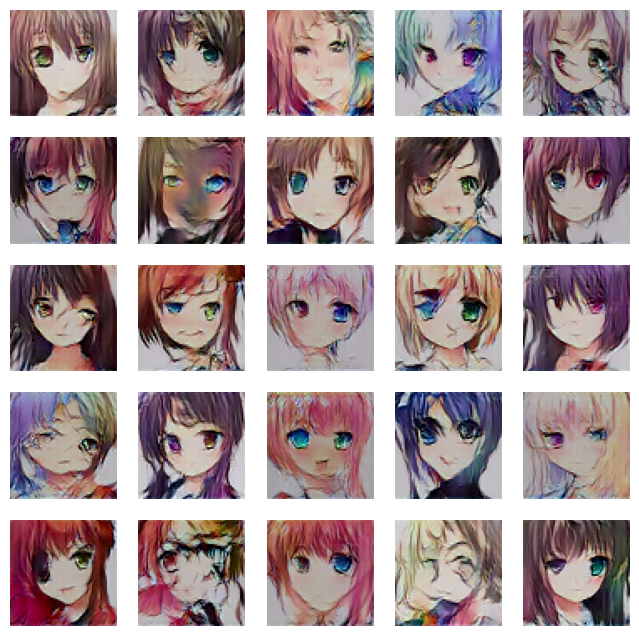

674/674 [==============================] - 48s 71ms/step - d_loss: 0.6993 - g_loss: 0.6721
Epoch 41/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6981 - g_loss: 0.6727

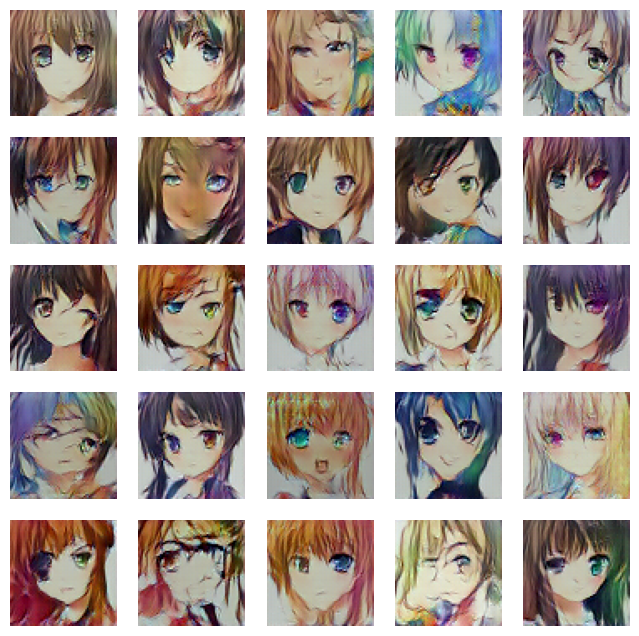

674/674 [==============================] - 48s 71ms/step - d_loss: 0.6981 - g_loss: 0.6728
Epoch 42/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6972 - g_loss: 0.6768

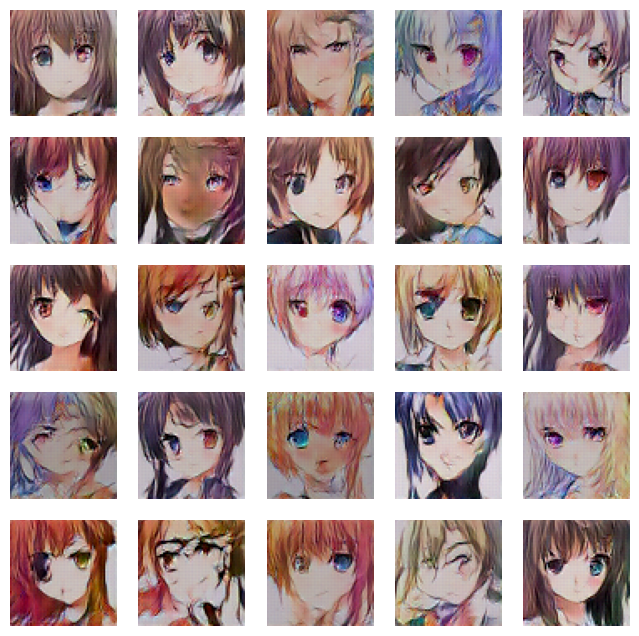

674/674 [==============================] - 48s 71ms/step - d_loss: 0.6973 - g_loss: 0.6768
Epoch 43/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6976 - g_loss: 0.6760

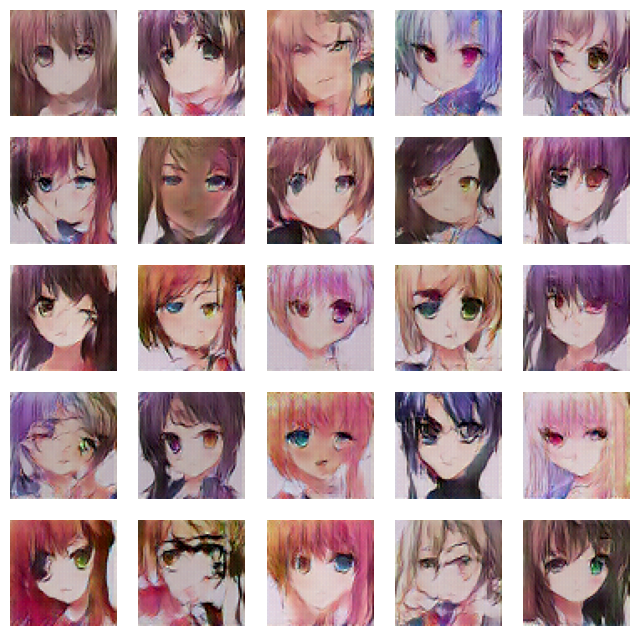

674/674 [==============================] - 49s 72ms/step - d_loss: 0.6976 - g_loss: 0.6760
Epoch 44/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6956 - g_loss: 0.6777

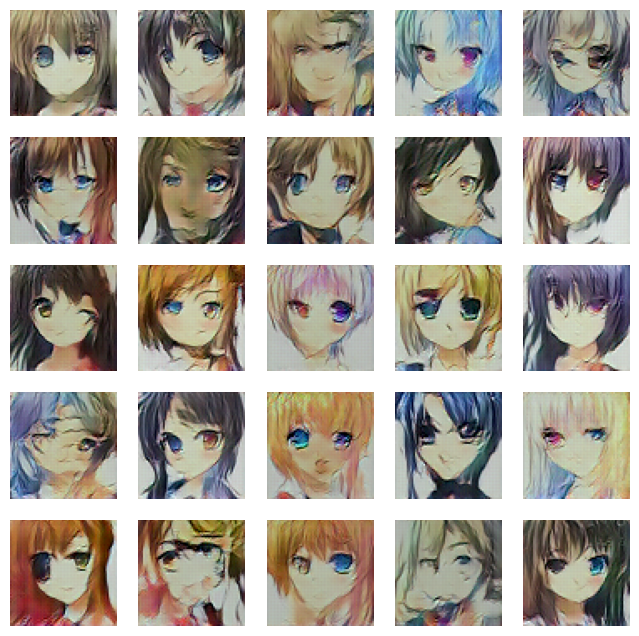

674/674 [==============================] - 48s 71ms/step - d_loss: 0.6956 - g_loss: 0.6777
Epoch 45/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6959 - g_loss: 0.6790

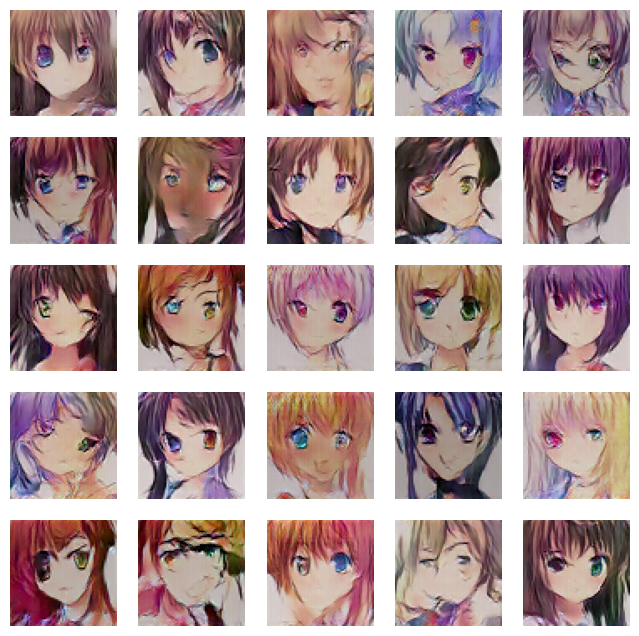

674/674 [==============================] - 48s 71ms/step - d_loss: 0.6959 - g_loss: 0.6790
Epoch 46/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6954 - g_loss: 0.6815

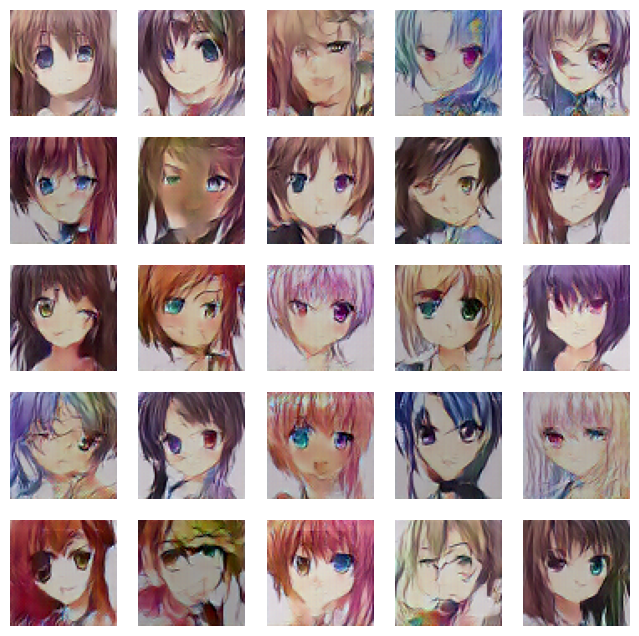

674/674 [==============================] - 48s 71ms/step - d_loss: 0.6954 - g_loss: 0.6814
Epoch 47/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6943 - g_loss: 0.6826

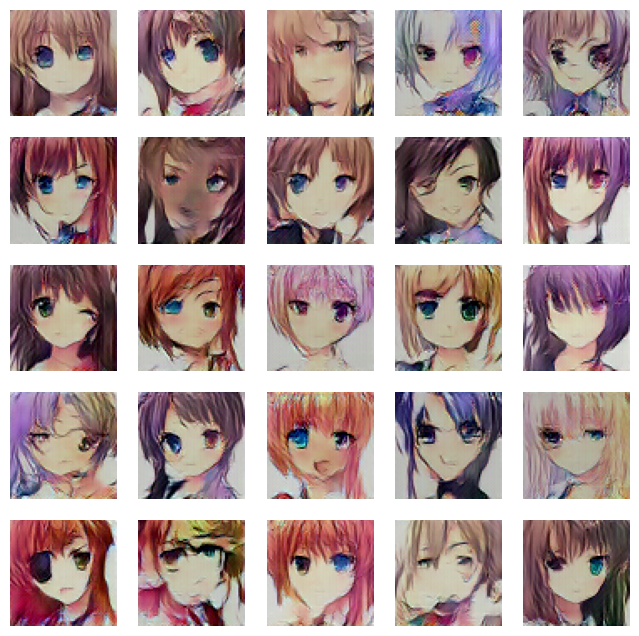

674/674 [==============================] - 49s 72ms/step - d_loss: 0.6942 - g_loss: 0.6826
Epoch 48/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6933 - g_loss: 0.6864

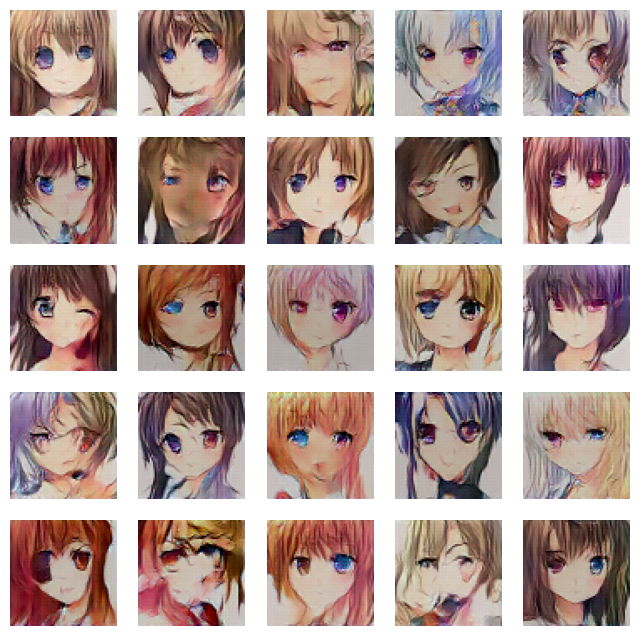

674/674 [==============================] - 48s 71ms/step - d_loss: 0.6933 - g_loss: 0.6862
Epoch 49/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6924 - g_loss: 0.6897

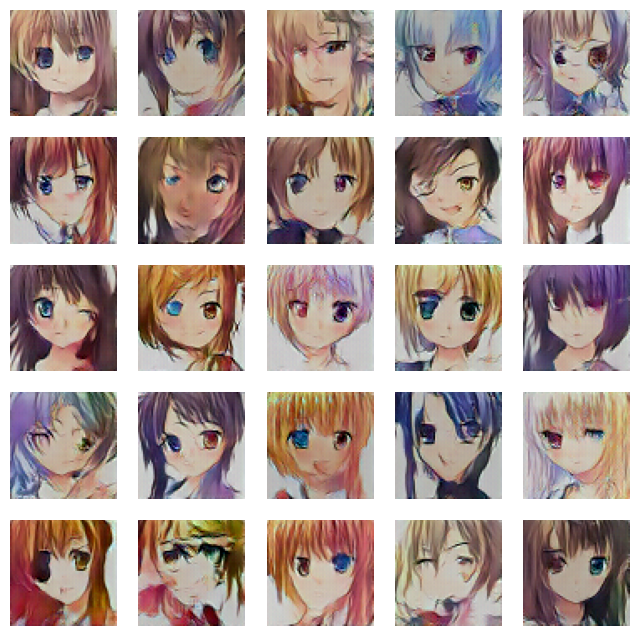

674/674 [==============================] - 48s 71ms/step - d_loss: 0.6924 - g_loss: 0.6897
Epoch 50/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6911 - g_loss: 0.6900

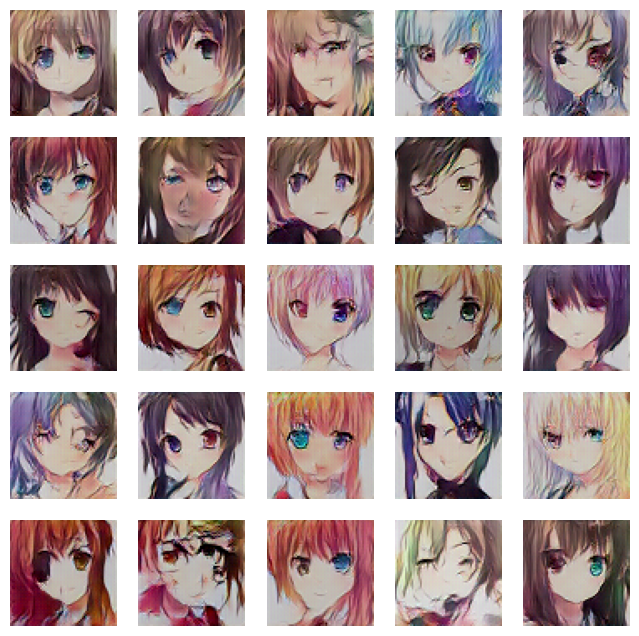

674/674 [==============================] - 48s 71ms/step - d_loss: 0.6910 - g_loss: 0.6900


In [48]:
N_EPOCHS = 50
dcgan_.fit(train_images, epochs=N_EPOCHS, callbacks=[DCGANMonitor()])

# Generate New Anime Image

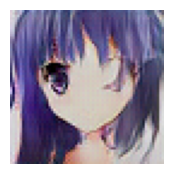

In [56]:
noise = tf.random.normal([1, 100])
fig = plt.figure(figsize=(2, 2))
# generate the image from noise
g_img = dcgan_.generator(noise)
# denormalize the image
#g_img = (g_img * 127.5) + 127.5
g_img.numpy()
img = array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
# plt.savefig('epoch_{:03d}.png'.format(epoch))
plt.show()

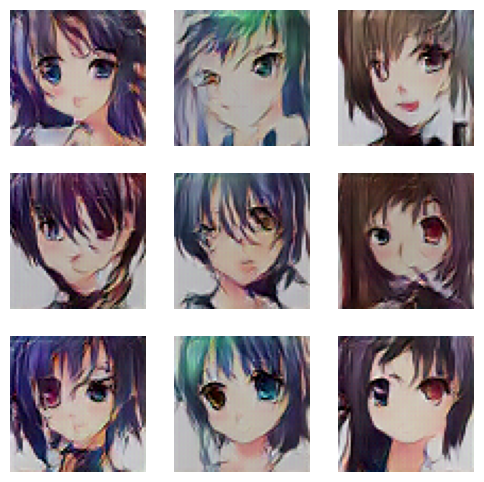

In [73]:
num_imgs = 9
noise = tf.random.normal([num_imgs, 100])
g_img = dcgan_.generator(noise)
# denormalize the image
#g_img = preprocess(g_img, while_train = True)

fig = plt.figure(figsize=(6, 6))
for i in range(num_imgs):
    plt.subplot(3, 3, i+1)
    img = array_to_img(g_img[i])
    plt.imshow(img)
    plt.axis('off')
# plt.savefig('epoch_{:03d}.png'.format(epoch))
plt.show()